# Nettoyage et exploration des données en lien avec les bus et tram d'Angers 

## 1. Import des packages principaux

In [2]:
import pandas as pd
from pandas.io.json import json_normalize
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import warnings

import requests 
import json

warnings.filterwarnings('ignore')
%matplotlib inline

import dtale

### 2.1 Import des données à partir de l'api de la ville d'Angers

In [3]:
r = requests.get("https://data.angers.fr/api/records/1.0/search/",
    params = {    
        "dataset":"bus-tram-position-tr",
        "rows":-1,    
    },
)

r.raise_for_status()
    
d = r.json()
#d

In [4]:
df_api = pd.json_normalize(d['records'])

### 2.2 Import des données à partir de la base consolidées des différents .json

In [5]:
df = pd.read_csv("angers_bus_tram_json_merge.csv", sep=";", encoding="utf-8")
df.sample(5)

,Unnamed: 0,datasetid,recordid,record_timestamp,fields.iddesserte,fields.idvh,fields.numarret,fields.etat,fields.novh,fields.nomligne,...,fields.coordonnees,fields.idarret,fields.cap,fields.idparcours,fields.sv,fields.y,fields.x,fields.ts_maj,geometry.type,geometry.coordinates
422550,422550,bus-tram-position-tr,f48d83ae1fff87a101699f34fc3c268b8c3a139d,2019-08-23T16:29:54+00:00,268970791,268436257,25148.0,LIGN,801,PONTS CE <> AQUAVITA H. RECULEE,...,"[47.475771, -0.56679215]",1461816,22,268970752.0,0801,2279170,381213,2019-08-23T16:29:54+00:00,Point,"[-0.56679215, 47.475771]"
54265,54265,bus-tram-position-tr,359b48460d343971a62e059f22370543cb6614f8,2019-10-30T06:29:51.927000+00:00,270970900,268443879,7592.0,TARR,8423,ST CLEMENT St LAMBERT <> GARE,...,"[47.46376, -0.56296521]",1590749,241,270970880.0,3802,2277825,381452,2019-10-30T06:29:51+00:00,Point,"[-0.56296521, 47.46376]"
35682,35682,bus-tram-position-tr,e5e092a316c45b25ee5ea7c6684befd746d6b673,2019-10-25T12:59:56.369000+00:00,269451522,268436463,4827.0,LIGN,1007,ARDENNE <> ROSERAIE,...,"[47.511108, -0.59540966]",1580171,136,269451520.0,A10,2283176,379204,2019-10-25T12:59:55+00:00,Point,"[-0.59540966, 47.511108]"
95374,95374,bus-tram-position-tr,abb9c3fdc7e92b38615dfa2359b4ff247c92c750,2019-10-21T14:59:54.601000+00:00,268868650,268435992,25729.0,LIGN,536,BOUCHEMAINE <> Z I EST,...,"[47.448172, -0.60574642]",1573095,224,268868608.0,0609,2276213,378164,2019-10-21T14:59:54+00:00,Point,"[-0.60574642, 47.448172]"
381889,381889,bus-tram-position-tr,a6a2342aee1908680a1e3f0f9c6c10861fa59067,2019-11-26T10:44:56.705000+00:00,269037326,268435893,23465.0,LIGN,437,ESPACE ANJOU <> EVENTARD,...,"[47.470267, -0.54749607]",1641278,38,269037312.0,0906,2278505,382644,2019-11-26T10:44:56+00:00,Point,"[-0.54749607, 47.470267]"


## 3. Nettoyage des données 

On supprime les colonnes inutiles et on transforme les types de données.

In [6]:
df = (df
        .drop(columns=["Unnamed: 0", "datasetid", "recordid", "geometry.type"], errors='ignore')
        .astype({"record_timestamp": "datetime64", "fields.ts_maj": "datetime64", "fields.coordonnees" : "string"})
        .assign(ecart_horodatage = lambda x: x["record_timestamp"] - x["fields.ts_maj"])
)


On renomme les colonnes pour une meilleure lecture et utilisation des métadonnés.

In [7]:
nomsColonnes = ['horodatage', 
                'identifiant_SAE_de_desserte',
                'identifiant_du_vehicule',
                'numero_Timeo_de_l_arret',
                'etat_SAE_du_vehicule', 
                'numero_de_parc_du_vehicule',
                'nom_de_la_ligne',
                'Heure_estimee_de_passage_a_L_arret', 
                'modele_du_vehicule',
                'identifiant_SAE_de_ligne',
                'ecart_horaire_en_secondes',
                'destination',
                'nom_de l_arret', 
                'mne_de_l_arret',
                'mnemo_de_la_ligne',
                 'coordonnees_GPS_WG84', 
                'identifiant_SAE_de_l_arret',
                'cap_du_vehicule_en_degres', 
                'identifiant_SAE_du_parcours',
                'service_voiture', 
                'coordonnees_GPS_X',
                'coordonnees_GPS_Y', 
                'horodatage_maj',
                'cordonnees_bus_geometrie', 
                'ecart_horodatage']


df.columns = nomsColonnes

On supprime les doublons qui vont fausser nos analyses. 

In [8]:
# index des lignes dupliquées (on drop les unhashable)
duplicateRowsDF = df[df.drop(columns=["cordonnees_bus_geometrie", "coordonnees_GPS_WG84"]).duplicated()]
#display(duplicateRowsDF.sort_values(by="horodatage").head(10))

# drop des lignes dupliquées par index
df = df.drop(duplicateRowsDF.index, axis=0)
df.shape


(728442, 25)

On regarde le nombres de NA, ici 14 770.

Actuellement, la décision est de les supprimer.

In [9]:
print("Nbr NA avant suppression : ", df.isna().sum().sum())

df = df.dropna()

print("Nbr NA avant suppression :", df.isna().sum().sum())

Nbr NA avant suppression :  14770
Nbr NA avant suppression : 0


On va s'occupe des données abérantes (outsiders). 

On utilise la méthode de winsorizing sur les données : 
- inférieur à q1 - 1.5 * irq,
- supérieur à q3 + 1.5 * irq. 



In [10]:
from scipy.stats.mstats import winsorize

fig = px.box(df, y="ecart_horaire_en_secondes")
fig.show()

df["ecart_horaire_en_secondes"] = winsorize(df["ecart_horaire_en_secondes"], limits=[0.05, 0.05])

fig = px.box(df, y="ecart_horaire_en_secondes")
fig.show()

On développe la nootion des coordonnées GPS, l'idée étant de séparer la latitude et la longitude. 

In [11]:
df[['latitude', 'longitude']] = df['coordonnees_GPS_WG84'].str.split(',', expand=True)

cols = ['latitude', 'longitude']
for col in cols :
    df[col] = df[col].map(lambda x: str(x).lstrip('[').rstrip(']')).astype(float)


De plus, on divise la colonne horodatage en plusieurs colonnes numériques qui vont être utile à l'affichage des analyses :
On récupère :
- l'année,
- le mois,
- le jour,
- la date sur un nouveau format, 
- la date avec l'heure,
- le jour de la semaine. 

In [12]:
df["year"] = df["horodatage"].dt.year
df["month"] = df["horodatage"].dt.month
df["day"] =  df["horodatage"].dt.day
df["hours"] = df["horodatage"].dt.hour
df["date"] = pd.to_datetime(df[["year", "month", "day"]])
df["date_heure"] = pd.to_datetime(df[["year", "month", "day", "hours"]])

df["jour_semaine"] = df["date"].dt.day_name().map({"Monday": "Lundi", "Tuesday": "Mardi", "Wednesday": "Mercredi", "Thursday": "Jeudi", "Friday": "Vendredi", "Saturday": "Samedi", "Sunday": "Dimanche"})

#df.sample(5)

Left join Météo

In [14]:
df_meteo = pd.read_csv('export-angers_meteo.csv', sep=';')
df_meteo.tail()


,DATE,MAX_TEMPERATURE_C,MIN_TEMPERATURE_C,WINDSPEED_MAX_KMH,TEMPERATURE_MORNING_C,TEMPERATURE_NOON_C,TEMPERATURE_EVENING_C,PRECIP_TOTAL_DAY_MM,HUMIDITY_MAX_PERCENT,VISIBILITY_AVG_KM,...,WEATHER_CODE_MORNING,WEATHER_CODE_NOON,WEATHER_CODE_EVENING,TOTAL_SNOW_MM,UV_INDEX,SUNHOUR,OPINION,SUNSET,SUNRISE,TEMPERATURE_NIGHT_C
148,2019-12-27,12,10,21,11,12,11,0.0,92,9.0,...,122,119,143,0,3,3.3,météo défavorable,17:17:00,08:49:00,11
149,2019-12-28,9,5,10,6,9,6,0.0,94,10.0,...,113,119,113,0,2,5.1,météo défavorable,17:18:00,08:49:00,7
150,2019-12-29,6,2,11,2,6,4,0.0,93,8.0,...,113,113,113,0,1,8.7,météo très défavorable,17:19:00,08:50:00,2
151,2019-12-30,10,2,8,2,8,6,0.0,65,10.0,...,113,113,113,0,3,8.7,météo très défavorable,17:20:00,08:50:00,2
152,2019-12-31,9,3,8,3,8,5,0.0,84,8.0,...,113,113,143,0,3,8.7,météo très défavorable,17:21:00,08:50:00,4


In [15]:
df_meteo['DATE'] = pd.to_datetime(df_meteo['DATE'], format='%Y-%m-%d')
df['horodatage_round'] = df['horodatage'].dt.round('d')
df = pd.merge(df, df_meteo, how='left',
              left_on='horodatage_round', right_on='DATE')
df.tail()


,horodatage,identifiant_SAE_de_desserte,identifiant_du_vehicule,numero_Timeo_de_l_arret,etat_SAE_du_vehicule,numero_de_parc_du_vehicule,nom_de_la_ligne,Heure_estimee_de_passage_a_L_arret,modele_du_vehicule,identifiant_SAE_de_ligne,...,WEATHER_CODE_MORNING,WEATHER_CODE_NOON,WEATHER_CODE_EVENING,TOTAL_SNOW_MM,UV_INDEX,SUNHOUR,OPINION,SUNSET,SUNRISE,TEMPERATURE_NIGHT_C
724197,2019-11-03 20:14:55.356,270033666,268436279,26006.0,HLPR,823,DJF LORRAINE <> ST BARTHELEMY,2019-11-02T23:00:00+00:00,CITYSTD,268435480,...,116,353,122,0,3,5.4,météo correcte,17:41:00,07:50:00,12
724198,2019-11-03 20:14:55.356,269451532,268436469,29904.0,LIGN,1013,ARDENNE <> ROSERAIE,2019-11-03T20:14:51+00:00,CITADIS,268435471,...,116,353,122,0,3,5.4,météo correcte,17:41:00,07:50:00,12
724199,2019-11-03 20:14:55.356,269825813,268436070,27063.0,LIGN,614,DJF BELLE BEILLE <> MONPLAISIR,2019-11-03T20:15:10+00:00,MAN City,268435477,...,116,353,122,0,3,5.4,météo correcte,17:41:00,07:50:00,12
724200,2019-11-03 20:14:55.356,269419020,268436459,8368.0,LIGN,1003,ARDENNE <> ROSERAIE,2019-11-03T20:15:02+00:00,CITADIS,268435471,...,116,353,122,0,3,5.4,météo correcte,17:41:00,07:50:00,12
724201,2019-11-03 20:13:53.682,269902082,268436150,26006.0,HLPR,694,DJF TRELAZE <> ST SYLVAIN,2019-11-02T23:00:00+00:00,CITYART,268435478,...,116,353,122,0,3,5.4,météo correcte,17:41:00,07:50:00,12


<AxesSubplot: xlabel='ecart_horaire_en_secondes', ylabel='OPINION'>

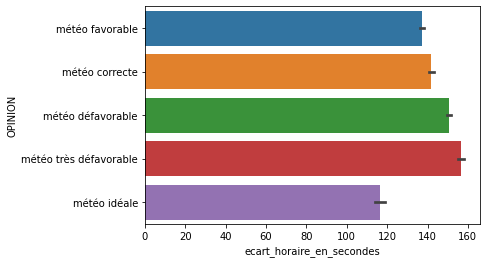

In [17]:
sns.barplot(y="OPINION", x="ecart_horaire_en_secondes", data=df)


Left join Arret pour obtenir la variable de distance à celui ci : https://data.angers.fr/explore/dataset/horaires-theoriques-et-arrets-du-reseau-irigo-gtfs/export/

In [ ]:
# left arret ici.

On en arrive à un dataframe de la forme suivante, avec 60 colonnes et 724 202 observations. 

In [18]:
print(df.shape)
#dtale.show(df)

(724202, 60)


On affiche les informations de nos données. 

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 724202 entries, 0 to 724201
Data columns (total 60 columns):
 #   Column                              Non-Null Count   Dtype          
---  ------                              --------------   -----          
 0   horodatage                          724202 non-null  datetime64[ns] 
 1   identifiant_SAE_de_desserte         724202 non-null  int64          
 2   identifiant_du_vehicule             724202 non-null  int64          
 3   numero_Timeo_de_l_arret             724202 non-null  float64        
 4   etat_SAE_du_vehicule                724202 non-null  object         
 5   numero_de_parc_du_vehicule          724202 non-null  int64          
 6   nom_de_la_ligne                     724202 non-null  object         
 7   Heure_estimee_de_passage_a_L_arret  724202 non-null  object         
 8   modele_du_vehicule                  724202 non-null  object         
 9   identifiant_SAE_de_ligne            724202 non-null  int64          
 

Sauvegarde pour prédiction

In [20]:
df.to_csv("bus_trafic_clean.csv", encoding="utf-8")

## 4 Analyse de nos données 

### 4.1 Analyse générale 

In [ ]:
print("Premiere date : ", df["horodatage"].min().strftime("%Y-%m-%d"))
print("Derniere date : ", df["horodatage"].max().strftime("%Y-%m-%d"))
print("Nombre de jours étudiés : ", (df["horodatage"].max() - df["horodatage"].min()).days)
print("Nombre de véhicules différents : ", df["identifiant_du_vehicule"].nunique())
print("Nombre de lignes différentes : ", df["nom_de_la_ligne"].nunique())


Premiere date :  2019-08-05
Derniere date :  2019-12-12
Nombre de jours étudiés :  128
Nombre de véhicules différents :  285
Nombre de lignes différentes :  44


### 4.2 Analyse des retard => écart horaire 

In [ ]:
# nombre de bus avec ecart_hoiraire_en_seconde > 0 
tab_ecart = [len(df[df["ecart_horaire_en_secondes"] > 0]), len(df[df["ecart_horaire_en_secondes"] < 0]) , len(df[df["ecart_horaire_en_secondes"] == 0])]
tab_label = ["Vehicule en retard", "Véhicule en avance", "Véhicule à l'heure"]

fig = go.Figure(data=[go.Pie(labels=tab_label, values=tab_ecart, pull = [0,0.2,0])])
fig.show()


In [ ]:
ecart_jour = df.groupby(['month'])['ecart_horaire_en_secondes'].count()

#ecart_jour.plot(kind='bar',figsize=(12,7), color='magenta', alpha=0.5)$
fig = px.bar(ecart_jour, 
            x=ecart_jour.index, 
            y='ecart_horaire_en_secondes', 
            title="Nombre de retard par mois en seconde",
            color='ecart_horaire_en_secondes')
fig.show()

In [ ]:
df_plot_ecart = df[['month', 'day', 'ecart_horaire_en_secondes']]
df_plot_ecart = df_plot_ecart.groupby(['month', 'day']).sum().reset_index()
#display(df_plot_ecart)

df_plot_ecart_8 = df_plot_ecart[df_plot_ecart['month'] == 8]
df_plot_ecart_9 = df_plot_ecart[df_plot_ecart['month'] == 9]
df_plot_ecart_10 = df_plot_ecart[df_plot_ecart['month'] == 10]
df_plot_ecart_11 = df_plot_ecart[df_plot_ecart['month'] == 11]
df_plot_ecart_12 = df_plot_ecart[df_plot_ecart['month'] == 12]

fig = make_subplots(rows=2, cols=3)
fig.add_trace(go.Line(x=df_plot_ecart_8['day'], y=df_plot_ecart_8['ecart_horaire_en_secondes'], name = "Août"), row=1, col=1)
fig.add_trace(go.Line(x=df_plot_ecart_9['day'], y=df_plot_ecart_9['ecart_horaire_en_secondes'], name = "Septembre"), row=1, col=2)
fig.add_trace(go.Line(x=df_plot_ecart_10['day'], y=df_plot_ecart_10['ecart_horaire_en_secondes'], name = "Octobre"), row=1, col=3)
fig.add_trace(go.Line(x=df_plot_ecart_11['day'], y=df_plot_ecart_11['ecart_horaire_en_secondes'], name = "Novembre"), row=2, col=1)
fig.add_trace(go.Line(x=df_plot_ecart_12['day'], y=df_plot_ecart_12['ecart_horaire_en_secondes'], name = "Décembre"), row=2, col=2)
fig.update_layout(yaxis_range=[0, 2500000])
fig.show()

c:\Users\clovi\AppData\Local\Programs\Python\Python310\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [ ]:
fig = px.bar(df_plot_ecart, 
            x='day',
            y='ecart_horaire_en_secondes',
            animation_frame="month",
            range_y=[0,2500000],
            )
fig.show()

In [ ]:
df_heatmap_ecart = df[['month', 'day', 'ecart_horaire_en_secondes']]
df_heatmap_ecart = df_heatmap_ecart.groupby(['month', 'day']).sum().reset_index()
df_heatmap_ecart = df_heatmap_ecart.pivot("month", "day", "ecart_horaire_en_secondes")
df_heatmap_ecart = df_heatmap_ecart.fillna(0)
df_heatmap_ecart.index = ["Août", "Septembre", "Octobre", "Novembre", "Décembre"]

px.imshow(df_heatmap_ecart, labels=dict(x="Jour", y="Mois", color="Ecart en seconde", height=1000, width=500, aspect="auto"))

### Analyse des différents modèles de véhicules

In [ ]:
# repartition identifiant et modele du vehicule
df_plot_vehicule_repartition = df[['identifiant_du_vehicule', 'modele_du_vehicule']].drop_duplicates()
df_plot_vehicule_repartition["count"] = 1
df_plot_vehicule_repartition = df_plot_vehicule_repartition.groupby(['modele_du_vehicule']).sum().reset_index().drop(columns=["identifiant_du_vehicule"])

fig = px.bar(df_plot_vehicule_repartition, 
            x='modele_du_vehicule', 
            y='count', 
            title="Répartition des différents modèles de véhicules",
            color='count')
fig.show()

### Analyse de l'état des véhicules 

> 'HLP', course en Haut le pied (course sans client, entre dépôt et terminus)
> 'TARR', Terminus arrivée
> 'TDEP' Terminus Départ
> 'LIGN' En ligne commerciale

In [ ]:
df_plot_vehicule_etat = df[['identifiant_du_vehicule', 'etat_SAE_du_vehicule', 'month', 'day']].drop_duplicates()
df_plot_vehicule_etat["count"] = 1
df_plot_vehicule_etat = df_plot_vehicule_etat.groupby(['month', 'day', 'etat_SAE_du_vehicule']).sum().reset_index().drop(columns=["identifiant_du_vehicule"])
#display(df_plot_vehicule_etat)

fig = px.bar(df_plot_vehicule_etat, x='day', y='count', animation_frame="month", color='etat_SAE_du_vehicule')
fig.show()

### Analyse des différentes lignes de bus / tram 

In [ ]:
# nombre de bus moyen par lignes
df_plot_bus_par_ligne = df[['date', 'month', 'identifiant_du_vehicule', 'mnemo_de_la_ligne']].drop_duplicates()
df_plot_bus_par_ligne["count"] = 1
df_plot_bus_par_ligne = df_plot_bus_par_ligne.groupby(['date', 'month', 'mnemo_de_la_ligne']).sum().reset_index().drop(columns=["identifiant_du_vehicule"])
display(df_plot_bus_par_ligne)

# moyenne par mnemo_de_la_ligne
df_plot_bus_par_ligne_moyenne = df_plot_bus_par_ligne.groupby(['mnemo_de_la_ligne']).mean().round(0).reset_index().drop(columns=["month"])
#display(df_plot_bus_par_ligne_moyenne)

# moyenne de mnemo_de_la_ligne par mois
df_plot_bus_par_ligne_moyenne_par_mois = df_plot_bus_par_ligne.groupby(['month', 'mnemo_de_la_ligne']).mean().round(0).reset_index()
#display(df_plot_bus_par_ligne_moyenne_par_mois.sort_values(by=["month","mnemo_de_la_ligne"]))


,date,month,mnemo_de_la_ligne,count
0,2019-08-05,8,01,6
1,2019-08-05,8,02,8
2,2019-08-05,8,03,5
3,2019-08-05,8,04,7
4,2019-08-05,8,05,6
...,...,...,...,...
3657,2019-12-12,12,38,4
3658,2019-12-12,12,39,7
3659,2019-12-12,12,42,5
3660,2019-12-12,12,43,3


In [ ]:
list_unique_mnemo_de_la_ligne = df_plot_bus_par_ligne.mnemo_de_la_ligne.unique().tolist()

button_list = []
for items in list_unique_mnemo_de_la_ligne:
    button_list.append(dict(label=items,
                            method="update",
                            args=[{"visible": [items in l for l in df_plot_bus_par_ligne["mnemo_de_la_ligne"]]},
                                  {"title": "Nombre de bus moyen par lignes : {}".format(items)}]))

# plotly drowpdown from list_unique_mnemo_de_la_ligne
fig = px.line(df_plot_bus_par_ligne, x="date", y="count", color='mnemo_de_la_ligne', title="Nombre de bus moyen par lignes")
fig.update_layout(
    updatemenus=[
        go.layout.Updatemenu(
            buttons = button_list,
            direction = "down",
            pad={"r": 10, "t": 10},
            showactive = True
        )
    ]
)
fig.show()


In [ ]:
# ecart horaire par ligne
df_plot_ecart_horaire_par_ligne = df[['date_heure', 'month', 'identifiant_du_vehicule', 'mnemo_de_la_ligne', 'ecart_horaire_en_secondes']]
display(df_plot_ecart_horaire_par_ligne)


,date_heure,month,identifiant_du_vehicule,mnemo_de_la_ligne,ecart_horaire_en_secondes
0,2019-10-12 13:00:00,10,268436058,04,0
1,2019-10-12 13:00:00,10,268436266,06,0
2,2019-10-12 13:00:00,10,268436471,A,0
3,2019-10-12 13:00:00,10,268435657,01,748
4,2019-10-12 13:00:00,10,268435909,10,115
...,...,...,...,...,...
765406,2019-11-03 20:00:00,11,268436279,4D,0
765407,2019-11-03 20:00:00,11,268436469,A,309
765408,2019-11-03 20:00:00,11,268436070,1D,-49
765409,2019-11-03 20:00:00,11,268436459,A,-7


In [ ]:
df_plot_ecart_horaire_par_ligne_all = df_plot_ecart_horaire_par_ligne
df_plot_ecart_horaire_par_ligne_all["count"] = 1
df_plot_ecart_horaire_par_ligne_all = df_plot_ecart_horaire_par_ligne_all.groupby(['mnemo_de_la_ligne']).sum().reset_index().drop(columns=['month','identifiant_du_vehicule'])
df_plot_ecart_horaire_par_ligne_all["moyenne_retard"] = round(df_plot_ecart_horaire_par_ligne_all["ecart_horaire_en_secondes"] / df_plot_ecart_horaire_par_ligne_all["count"],0)

display(df_plot_ecart_horaire_par_ligne_all)

# passage en minute
# affichage globale

# affichage heatmap en fct des mois / ligne




,mnemo_de_la_ligne,ecart_horaire_en_secondes,count,moyenne_retard
0,01,15340299,77195,199.0
1,02,9600770,68272,141.0
2,03,6914553,49194,141.0
3,04,9832619,64262,153.0
4,05,9698591,54128,179.0
5,06,5264158,47426,111.0
6,07,2895744,29204,99.0
7,08,3405449,28892,118.0
8,09,5686971,30789,185.0
9,10,6028514,34617,174.0


### Implémentation géographique des différents bus / trams en fonction du temps 

In [ ]:
import folium
from folium import plugins
from folium.plugins import HeatMapWithTime
from folium.plugins import HeatMap
import datetime

def generateBaseMap(default_location=[47.478419, -0.563166], default_zoom_start=11):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=14)
    return base_map

base_map = generateBaseMap()


In [ ]:
df_map = df[['date_heure', 'latitude', 'longitude']]
df_map["count"] = 1
df_map['count'] = df_map[['date_heure', 'latitude', 'longitude', 'count']].groupby(['latitude', 'longitude', 'date_heure']).transform('count')

#df_map.head(10)

In [ ]:
df_map['date_heure']= pd.to_datetime(df_map['date_heure'])
temps_index = []
for i in df_map['date_heure'].unique():
    temps_index.append(i)
date_labels = [pd.to_datetime(str(d)).strftime('%d/%m/%Y, %H') for d in temps_index]

date_labels = [x for _,x in sorted(zip(temps_index,date_labels))]
date_labels


lat_long_list = []
for i in df_map['date_heure'].unique():
    temp=[]
    for index, instance in df_map[df_map['date_heure'] == i].iterrows():
        temp.append([instance['latitude'],instance['longitude']])
    lat_long_list.append(temp)

In [ ]:
base_map = generateBaseMap()

#cluster = plugins.MarkerCluster().add_to(base_map)

#HeatMap(data=df_map[['latitude', 'longitude', 'count']].groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)

HeatMapWithTime(lat_long_list,radius=5,auto_play=True,position='bottomright',name="cluster", index=date_labels, max_opacity=0.9).add_to(base_map)


base_map